In [19]:
from experiment import Experiment
import numpy as np
from agent import Agent
from enviroment import Environment
import matplotlib.pyplot as plt
import seaborn as sn
import pandas as pd

from utils import map_vote, cal_result

In [87]:
candidates = ['c1','c2','c3','c4','c5']
voting_scheme = ['plurality', 'voting_for_two', 'anti_plurality', 'borda']
strategy = 'combination'
happiness_type = 'A'
# number_of_agents = 5
number_of_strategists = 1
trials = 30
agents_options = [3, 5, 10, 25, 50, 100]
candidates_options  = [2, 3, 4, 5, 10]
feature_type = ['delta_happiness_total',]


In [21]:
def create_candidate_list(number):
    # Create a list with "c" followed by the candidate number for each candidate
    return ["c" + str(i) for i in range(1, number + 1)]

# Testing the function with number=5
test_list = create_candidate_list(10)
test_list


['c1', 'c2', 'c3', 'c4', 'c5', 'c6', 'c7', 'c8', 'c9', 'c10']

In [6]:
# def heatmap_experiment(agents_options, candidates_options, feature_type, voting_scheme, strategy, happiness_type):
#     feature_list_final = []
#     for a in agents_options:
#         feature_list = []
#         for c in candidates_options:

#             feature = 0

#             for trial in range(30):    
#                 print("#"*50)
#                 exp = Experiment(id=trial, name=f'{trial}th_experiment')

#                 # Set experiment variables
#                 exp.set_exp_variables(create_candidate_list(c), voting_scheme, strategy, happiness_type, a,  1)

#                 initial_happiness, final_happiness = exp.run_exp()

#                 if feature_type == 'delta_happiness_total':
#                     feature += abs(initial_happiness - final_happiness)
            
#             if feature_type == 'delta_happiness_total':
#                 feature /= a
                
#             feature /= 30

#             feature_list.append(feature)

#         feature_list_final.append(feature_list)

#     fig, ax = plt.subplots()
#     sn.heatmap(feature_list_final, annot=True, ax=ax)
#     # Setting the tick labels and labels for each axis
#     ax.set_xticklabels(candidates_options, rotation=0, fontsize=12)  # You can adjust rotation and fontsize as needed
#     ax.set_yticklabels(agents_options, rotation=0, fontsize=16)

#     # Setting labels for the axes
#     ax.set_xlabel("Number of candidates", fontsize=14)
#     ax.set_ylabel("Number of agents", fontsize=14)

#     plt.title(f"happiness_type={happiness_type}, voting_scheme={voting_scheme}, strategy={strategy}")
#     plt.yticks(rotation=0,fontsize=16)
#     plt.xticks(fontsize=12)
#     plt.tight_layout()
#     plt.show()

In [7]:
# agents_options = [3, 5, 10, 25, 50, 100]
# candidates_options  = [3, 4, 5, 10]
# # agents_options = [3, 5]
# # candidates_options  = [2, 3]
# feature_type = ['delta_happiness_total',]
# heatmap_experiment(agents_options, candidates_options, feature_type[0], 'borda', 'combination', 'A')

In [93]:
def heatmap_experiment(agents_options, candidates_options, happiness_types, voting_schemes, strategy):
    fig, axs = plt.subplots(len(happiness_types), len(voting_schemes), figsize=(15, 10))
    
    feature_type = 'happiness'
    for i, happiness_type in enumerate(happiness_types):
        for j, voting_scheme in enumerate(voting_schemes):
            feature_list_final = []  # Reset for each subplot
            for a in agents_options:
                feature_list = []
                for c in candidates_options:
                    feature = 0
                    for trial in range(30):    
                        print("#"*50)
                        exp = Experiment(id=trial, name=f'{trial}th_experiment')

                        # Set experiment variables
                        exp.set_exp_variables(create_candidate_list(c), voting_scheme, strategy, happiness_type, a,  1)

                        initial_happiness, final_happiness, _ = exp.run_exp()
                        


                        if feature_type == 'happiness':
                            feature += abs(final_happiness - initial_happiness)
                            # feature += final_happiness - initial_happiness


                    if feature_type == 'happiness':
                        feature /= a
                        
                    feature /= 30

                    # feature /= (a * 30)
                    feature_list.append(feature)
                
                feature_list_final.append(feature_list)


            # Plotting each heatmap
            sn.heatmap(feature_list_final, annot=True, ax=axs[i, j], vmin=0, vmax=0.1, fmt=".3f")
            axs[i, j].set_title(f"{happiness_type}, {voting_scheme}")
            axs[i, j].set_xticklabels(candidates_options, rotation=0, fontsize=10)
            axs[i, j].set_yticklabels(agents_options, rotation=0, fontsize=10)
            if j == 0:
                axs[i, j].set_ylabel("Number of agents")
            if i == len(happiness_types) - 1:
                axs[i, j].set_xlabel("Number of candidates")



    plt.tight_layout()
    plt.show()

# # Example usage
# # This is a placeholder for your actual lists of options
# agents_options = [10, 20]
# candidates_options = [3, 4, 5]
# happiness_types = ["Happy", "Sad"]
# voting_schemes = ["Scheme1", "Scheme2"]
# strategy = "SomeStrategy"

# heatmap_experiment(agents_options, candidates_options, happiness_types, voting_schemes, strategy)


DEBUG [100, 50, 25, 10, 5, 3]
##################################################
exp_id: 0, exp_name: 0th_experiment
("[DEBUG]-[Env]- Agent: agent_0, strategic_agent: True, preference: ['c2', "
 "'c1', 'c3']\n")
[DEBUG]-[Env], votes: {'agent_0': array([0, 1, 0]), 'agent_1': array([1, 0, 0]), 'agent_2': array([0, 0, 1]), 'agent_3': array([0, 1, 0]), 'agent_4': array([0, 1, 0]), 'agent_5': array([1, 0, 0]), 'agent_6': array([0, 1, 0]), 'agent_7': array([0, 0, 1]), 'agent_8': array([1, 0, 0]), 'agent_9': array([0, 1, 0]), 'agent_10': array([0, 0, 1]), 'agent_11': array([0, 1, 0]), 'agent_12': array([1, 0, 0]), 'agent_13': array([1, 0, 0]), 'agent_14': array([1, 0, 0]), 'agent_15': array([0, 1, 0]), 'agent_16': array([0, 0, 1]), 'agent_17': array([0, 0, 1]), 'agent_18': array([1, 0, 0]), 'agent_19': array([0, 1, 0]), 'agent_20': array([1, 0, 0]), 'agent_21': array([1, 0, 0]), 'agent_22': array([1, 0, 0]), 'agent_23': array([0, 0, 1]), 'agent_24': array([0, 0, 1]), 'agent_25': array([0, 1, 

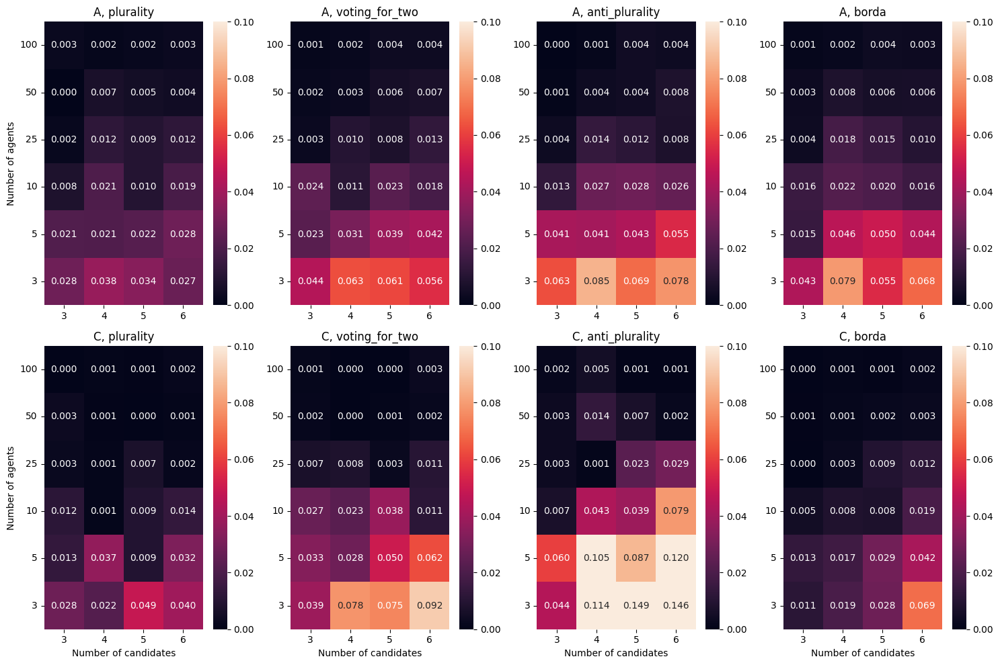

In [100]:
# agents_options = [3, 5, 10, 25, 50, 100]
# candidates_options  = [3, 4, 5, 6, 7]
# # agents_options = [3, 5]
# # candidates_options  = [2, 3]
# feature_type = ['delta_happiness_total',]
# This is a placeholder for your actual lists of options
agents_options = [3, 5, 10, 25, 50, 100]
agents_options.reverse()
print("DEBUG", agents_options)
candidates_options = [3, 4, 5, 6]
voting_schemes = ['plurality', 'voting_for_two', 'anti_plurality', 'borda']
strategy = 'combination'
happiness_types = ['A','C']

heatmap_experiment(agents_options, candidates_options, happiness_types, voting_schemes, strategy)

In [18]:
def heatmap_risk(agents_options, candidates_options, voting_schemes, strategy):
    fig, axs = plt.subplots(1, len(voting_schemes), figsize=(15, 7))
    
    for j, voting_scheme in enumerate(voting_schemes):
        risk_list_final = []  # Reset for each subplot
        for a in agents_options:
            risk_list = []
            for c in candidates_options:
                total_risk = 0
                for trial in range(30):    
                    print("#"*50)
                    exp = Experiment(id=trial, name=f'{trial}th_experiment')

                    # Set experiment variables
                    exp.set_exp_variables(create_candidate_list(c), voting_scheme, strategy, happiness_type, a,  1)
                    _,_,risk = exp.run_exp()

                    total_risk += risk

                total_risk /= 30

                    # feature /= (a * 30)
                risk_list.append(total_risk)
                
            risk_list_final.append(risk_list)

        sn.heatmap(risk_list_final, annot=True, ax=axs[j], fmt=".3f")
        axs[j].set_title(f"Risk for {voting_scheme}")
        axs[j].set_xticklabels(candidates_options, rotation=0, fontsize=10)
        axs[j].set_yticklabels(agents_options, rotation=0, fontsize=10)
        if j == 0:
            axs[j].set_ylabel("Number of agents")
        axs[j].set_xlabel("Number of candidates")
    
    plt.tight_layout()
    plt.show()

##################################################
exp_id: 0, exp_name: 0th_experiment
("[DEBUG]-[Env]- Agent: agent_0, strategic_agent: True, preference: ['c2', "
 "'c3', 'c1']\n")
[DEBUG]-[Env], votes: {'agent_0': array([0, 1, 0]), 'agent_1': array([0, 1, 0]), 'agent_2': array([0, 1, 0]), 'agent_3': array([0, 1, 0]), 'agent_4': array([0, 1, 0]), 'agent_5': array([1, 0, 0]), 'agent_6': array([1, 0, 0]), 'agent_7': array([0, 0, 1]), 'agent_8': array([0, 1, 0]), 'agent_9': array([0, 0, 1]), 'agent_10': array([1, 0, 0]), 'agent_11': array([0, 1, 0]), 'agent_12': array([0, 0, 1]), 'agent_13': array([0, 1, 0]), 'agent_14': array([0, 1, 0]), 'agent_15': array([1, 0, 0]), 'agent_16': array([1, 0, 0]), 'agent_17': array([0, 1, 0]), 'agent_18': array([0, 0, 1]), 'agent_19': array([0, 1, 0]), 'agent_20': array([1, 0, 0]), 'agent_21': array([1, 0, 0]), 'agent_22': array([1, 0, 0]), 'agent_23': array([0, 0, 1]), 'agent_24': array([0, 0, 1]), 'agent_25': array([0, 1, 0]), 'agent_26': array([0, 0, 

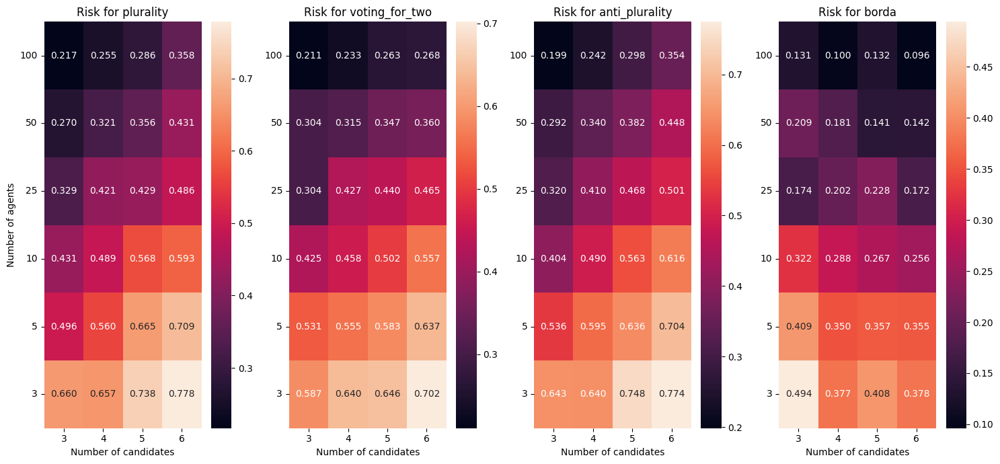

In [21]:
heatmap_risk(agents_options, candidates_options, voting_schemes, strategy)

##################################################
exp_id: 0, exp_name: 0th_experiment
("[DEBUG]-[Env]- Agent: agent_0, strategic_agent: True, preference: ['c2', "
 "'c3', 'c1']\n")
[DEBUG]-[Env], votes: {'agent_0': array([0, 1, 0]), 'agent_1': array([1, 0, 0]), 'agent_2': array([0, 0, 1]), 'agent_3': array([0, 0, 1]), 'agent_4': array([0, 0, 1]), 'agent_5': array([0, 0, 1]), 'agent_6': array([0, 1, 0]), 'agent_7': array([0, 0, 1]), 'agent_8': array([1, 0, 0]), 'agent_9': array([0, 1, 0]), 'agent_10': array([0, 1, 0]), 'agent_11': array([0, 0, 1]), 'agent_12': array([0, 0, 1]), 'agent_13': array([0, 0, 1]), 'agent_14': array([1, 0, 0]), 'agent_15': array([0, 0, 1]), 'agent_16': array([0, 0, 1]), 'agent_17': array([1, 0, 0]), 'agent_18': array([0, 1, 0]), 'agent_19': array([0, 0, 1]), 'agent_20': array([0, 1, 0]), 'agent_21': array([1, 0, 0]), 'agent_22': array([1, 0, 0]), 'agent_23': array([0, 0, 1]), 'agent_24': array([0, 0, 1]), 'agent_25': array([0, 1, 0]), 'agent_26': array([0, 1, 

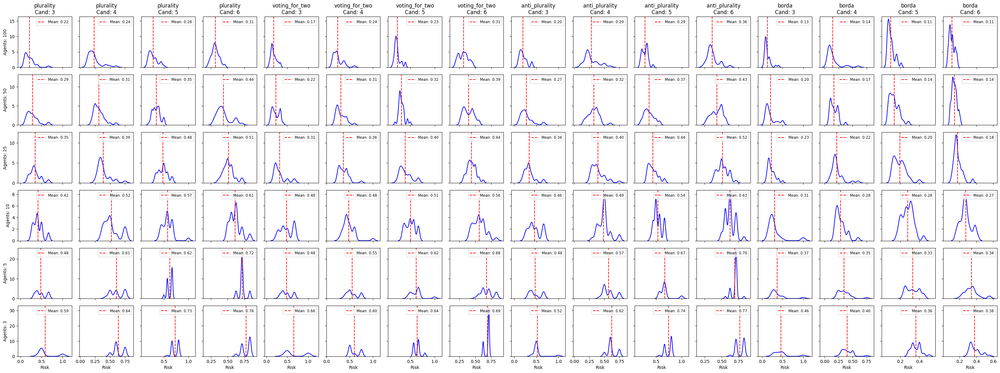

In [108]:
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np

def heatmap_risk_kde_improved(agents_options, candidates_options, voting_schemes, strategy, happiness_type):
    nrows = len(agents_options)
    ncols = len(candidates_options) * len(voting_schemes)
    
    fig, axs = plt.subplots(nrows=nrows, ncols=ncols, figsize=(2*ncols, 2*nrows), sharex='col', sharey='row')
    
    if nrows > 1:
        axs = axs.flatten()
    else:
        axs = [axs]  # Ensure axs is iterable even for a single subplot
    
    for i, voting_scheme in enumerate(voting_schemes):
        for j, num_agents in enumerate(agents_options):
            for k, num_candidates in enumerate(candidates_options):
                total_risks = []
                for trial in range(30):
                    print("#" * 50)
                    exp = Experiment(id=trial, name=f'{trial}th_experiment')
                    exp.set_exp_variables(create_candidate_list(num_candidates), voting_scheme, strategy, happiness_type, num_agents, 1)
                    _, _, risk = exp.run_exp()
                    total_risks.append(risk)
                
                ax_idx = j*len(candidates_options)*len(voting_schemes) + k + i*len(candidates_options)
                sns.kdeplot(total_risks, ax=axs[ax_idx], bw_adjust=0.5, color='blue')
                mean_risk = np.mean(total_risks)
                axs[ax_idx].axvline(mean_risk, color='red', linestyle='--', label=f'Mean: {mean_risk:.2f}')
                
                # Set titles for the top row and y-labels for the first column
                if j == 0:
                    axs[ax_idx].set_title(f'{voting_scheme}\nCand: {num_candidates}')
                if k == 0 and i == 0:
                    axs[ax_idx].set_ylabel(f'Agents: {num_agents}')
                
                # Hide x-axis labels for all but the bottom row plots
                if j < len(agents_options) - 1:
                    axs[ax_idx].set_xlabel('')
                else:
                    axs[ax_idx].set_xlabel('Risk')
                
                # Optionally, add the mean value as text within each subplot
                # axs[ax_idx].text(0.95, 0.95, f'Mean: {mean_risk:.2f}', horizontalalignment='right', verticalalignment='top', transform=axs[ax_idx].transAxes, color='red', fontsize=8)
                
                axs[ax_idx].legend(loc='upper right', fontsize='small')
    
    plt.tight_layout(pad=1.04)
    plt.show()

# Example usage
heatmap_risk_kde_improved(agents_options, candidates_options, voting_schemes, strategy, 'A')
    
# heatmap_risk_kde_improved(agents_options=[10, 20], candidates_options=[3, 5], voting_schemes=['Scheme 1', 'Scheme 2'], strategy='Strategy X', happiness_type='Type Y')


In [22]:
# PLACEHOLDER

def plot_strategic_voting_histograms(agents_options, candidates_options, happiness_types, voting_schemes, strategy):
    # Initialize an empty DataFrame to hold all experiment results
    all_data = pd.DataFrame(columns=['strategic_voters', 'feature_value', 'voting_scheme', 'happiness_type'])

    # Loop through all combinations of happiness types and voting schemes
    for happiness_type in happiness_types:
        for voting_scheme in voting_schemes:
            for a in agents_options:
                for c in candidates_options:
                    # Assuming a function 'run_experiment' that you define according to your experimental setup
                    # It should return the number of strategic voters and the feature value for each experiment run

                    
                    strategic_voters, feature_value = run_experiment(happiness_type, voting_scheme, a, c, strategy)

                    # Append the results to the DataFrame
                    all_data = pd.concat([all_data, pd.DataFrame({
                        'strategic_voters': [strategic_voters],
                        'feature_value': [feature_value],
                        'voting_scheme': [voting_scheme],
                        'happiness_type': [happiness_type]
                    })], ignore_index=True)

    # Setup the subplot grid
    fig, axs = plt.subplots(len(happiness_types), 1, figsize=(10, 5 * len(happiness_types)), squeeze=False)

    for i, happiness_type in enumerate(happiness_types):
        # Filter data for the current happiness type
        filtered_data = all_data[all_data['happiness_type'] == happiness_type]
        
        # Plotting
        sn.histplot(data=filtered_data, x='strategic_voters', hue='voting_scheme', multiple='stack',
                     bins=len(candidates_options) * len(agents_options),  # Adjust bins as necessary
                     kde=False, ax=axs[i, 0])
        
        axs[i, 0].set_title(f'Happiness Type: {happiness_type}')
        axs[i, 0].set_xlabel('Number of Strategic Voters')
        axs[i, 0].set_ylabel('Frequency')
        axs[i, 0].legend(title='Voting Scheme')

    plt.tight_layout()
    plt.show()

# Example placeholder for the experiment function
# Replace or modify this according to your actual experimental logic
def run_experiment(happiness_type, voting_scheme, agents, candidates, strategy):
    # Simulate running an experiment and return example data
    # You will replace this logic with your actual experiment execution
    strategic_voters = np.random.randint(1, 100)  # Simulated number of strategic voters
    feature_value = np.random.rand()  # Simulated feature value from the experiment
    return strategic_voters, feature_value


##################################################
exp_id: 5, exp_name: 5th_experiment
("[DEBUG]-[Env]- Agent: agent_0, strategic_agent: True, preference: ['c3', "
 "'c2', 'c1', 'c5', 'c4']\n")
[DEBUG]-[Env], votes: {'agent_0': array([0, 0, 1, 0, 0]), 'agent_1': array([0, 0, 1, 0, 0]), 'agent_2': array([0, 0, 1, 0, 0]), 'agent_3': array([0, 0, 0, 0, 1]), 'agent_4': array([0, 0, 0, 1, 0])} 

Initial voting result Dict: {'c3': 3, 'c4': 1, 'c5': 1, 'c1': 0, 'c2': 0}
Initial Total Happiness: 2.917
[Debug]-[Exp]- init_total_happiness: 2.917
[Debug]-[set_vote]- hap_init: 0.5
[Debug]-[set_vote]- max_hap: 0.733, best_pref: ['c2', 'c3', 'c1', 'c5', 'c4'], best_vote: [0 1 0 0 0]

[Debug]-[set_vote]- strategic_voted: True

[Debug]-[Env]- Best vote: [0 1 0 0 0] 
 Best pref: ['c2', 'c3', 'c1', 'c5', 'c4']
[DEBUG]-[Env], votes: {'agent_0': array([0, 1, 0, 0, 0]), 'agent_1': array([0, 0, 1, 0, 0]), 'agent_2': array([0, 0, 1, 0, 0]), 'agent_3': array([0, 0, 0, 0, 1]), 'agent_4': array([0, 0, 0, 1, 0])

C:\Users\30698\AppData\Local\Temp\ipykernel_7976\1605057351.py:39: UserWarning: You have mixed positional and keyword arguments, some input may be discarded.
  plt.legend('topright', labels=voting_scheme)


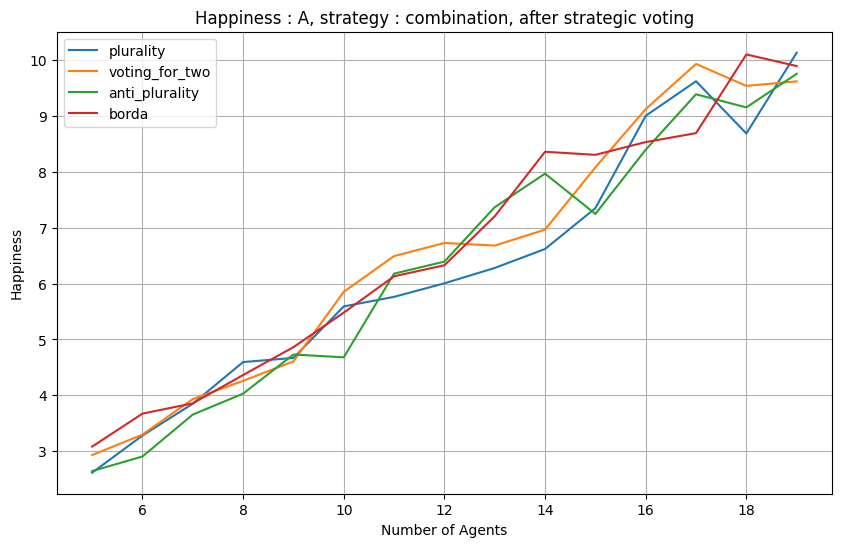

In [28]:
# ALL VOTING SCHEMES 

# initial_list = []
# final_list = []
initial_list_all_schemes = []
final_list_all_schemes = []

for scheme in voting_scheme:
    initial_list = []
    final_list = []
    for i in range(5,20):
        print("#"*50)
        exp = Experiment(id=i, name=f'{i}th_experiment')

        # Set experiment variables
        exp.set_exp_variables(candidates, scheme, strategy, happiness_type, i,  number_of_strategists)

        initial_happiness, final_happiness, _ = exp.run_exp()

        initial_list.append(initial_happiness)
        final_list.append(final_happiness)

    initial_list_all_schemes.append(initial_list)
    final_list_all_schemes.append(final_list)

# Generate x values from 1 up to the number of values
x = np.arange(5, len(initial_list) + 5)
print(x)
plt.figure(figsize=(10, 6))  # Optional: Specifies the figure size
plt.title(f'Happiness : {happiness_type}, strategy : {strategy}, after strategic voting')  # Add a title

for strat in range(4):
    # plt.plot(x, initial_list_all_strats[strat])  # Plot the line with circle markers
    plt.plot(x, final_list_all_schemes[strat])  # Plot the line with circle markers

plt.xlabel('Number of Agents')  # Add an x-label
plt.ylabel('Happiness')  # Add a y-label
plt.grid(True)  # Add gridlines for better readability
plt.legend('topright', labels=voting_scheme)
plt.show()  # Display the plot


##################################################
exp_id: 5, exp_name: 5th_experiment
("[DEBUG]-[Env]- Agent: agent_0, strategic_agent: True, preference: ['c5', "
 "'c2', 'c1', 'c3', 'c4']\n")
[DEBUG]-[Env], votes: {'agent_0': [2, 3, 1, 0, 4], 'agent_1': [4, 3, 0, 1, 2], 'agent_2': [4, 2, 0, 3, 1], 'agent_3': [0, 3, 1, 4, 2], 'agent_4': [0, 4, 1, 3, 2]} 

Initial voting result Dict: {'c2': 15, 'c4': 11, 'c5': 11, 'c1': 10, 'c3': 3}
Initial Total Happiness: 3.051
[Debug]-[Exp]- init_total_happiness: 3.051
[Debug]-[set_vote]- hap_init: 0.417
[Debug]-[set_vote]- max_hap: 0.5, best_pref: ['c3', 'c5', 'c2', 'c4', 'c1'], best_vote: [0 0 4 0 0]

[Debug]-[set_vote]- max_hap: 0.59, best_pref: ['c4', 'c5', 'c1', 'c2', 'c3'], best_vote: [0 0 0 4 0]

[Debug]-[set_vote]- strategic_voted: True

[Debug]-[Env]- Best vote: [0 0 0 4 0] 
 Best pref: ['c4', 'c5', 'c1', 'c2', 'c3']
[DEBUG]-[Env], votes: {'agent_0': array([0, 0, 0, 4, 0]), 'agent_1': [4, 3, 0, 1, 2], 'agent_2': [4, 2, 0, 3, 1], 'agent_3': 

C:\Users\30698\AppData\Local\Temp\ipykernel_17480\4232285934.py:43: UserWarning: You have mixed positional and keyword arguments, some input may be discarded.
  plt.legend('topright', labels=['initial', 'final'])


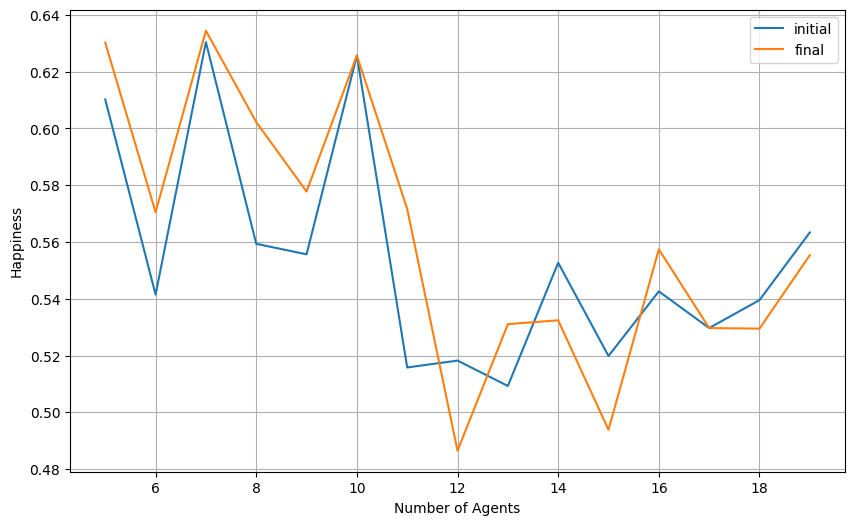

In [32]:
# INITIAL VS FINAL (NORMALIZED)

initial_list = []
final_list = []

for i in range(5,20):
    print("#"*50)
    exp = Experiment(id=i, name=f'{i}th_experiment')

    # Set experiment variables
    exp.set_exp_variables(candidates, 'borda', strategy, happiness_type, i,  number_of_strategists)

    initial_happiness, final_happiness = exp.run_exp()
    initial_list.append(initial_happiness)
    final_list.append(final_happiness)

average_initial = np.array(initial_list)/np.arange(5,20)
average_final = np.array(final_list)/np.arange(5,20)

# # Generate x values from 1 up to the number of values
# x = np.arange(5, len(initial_list)+5)

# plt.figure(figsize=(10, 6))  # Optional: Specifies the figure size
# plt.plot(x, initial_list)  # Plot the line with circle markers
# plt.plot(x, final_list)  # Plot the line with circle markers

# plt.title('')  # Add a title
# plt.xlabel('Number of Agents')  # Add an x-label
# plt.ylabel('Happiness')  # Add a y-label
# plt.grid(True)  # Add gridlines for better readability
# plt.legend('topright', labels=['initial', 'final'])
# plt.show()  # Display the plot

# Generate x values from 1 up to the number of values
x = np.arange(5, len(initial_list)+5)

plt.figure(figsize=(10, 6))  # Optional: Specifies the figure size
plt.plot(x, average_initial)  # Plot the line with circle markers
plt.plot(x,average_final)  # Plot the line with circle markers

plt.title('')  # Add a title
plt.xlabel('Number of Agents')  # Add an x-label
plt.ylabel('Happiness')  # Add a y-label
plt.grid(True)  # Add gridlines for better readability
plt.legend('topright', labels=['initial', 'final'])
plt.show()  # Display the plot

A = 0.09, x =[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49], value=[1.         0.5        0.33333333 0.25       0.2        0.16666667
 0.14285714 0.125      0.11111111 0.1        0.09090909 0.08333333
 0.07692308 0.07142857 0.06666667 0.0625     0.05882353 0.05555556
 0.05263158 0.05       0.04761905 0.04545455 0.04347826 0.04166667
 0.04       0.03846154 0.03703704 0.03571429 0.03448276 0.03333333
 0.03225806 0.03125    0.03030303 0.02941176 0.02857143 0.02777778
 0.02702703 0.02631579 0.02564103 0.025      0.02439024 0.02380952
 0.02325581 0.02272727 0.02222222 0.02173913 0.0212766  0.02083333
 0.02040816 0.02      ]


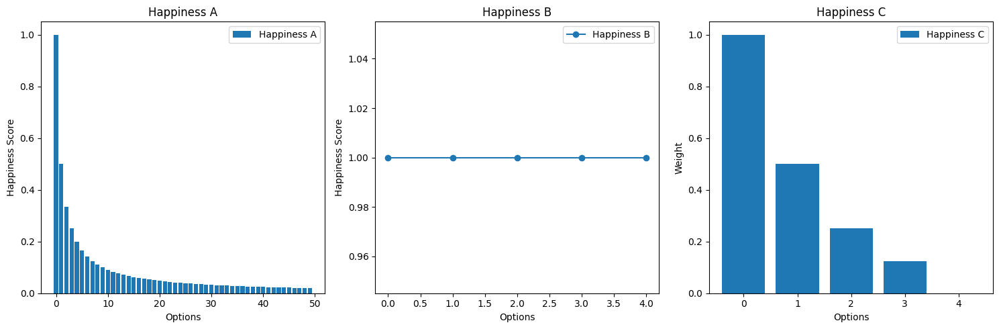

In [17]:
import numpy as np
import matplotlib.pyplot as plt
import random

def abs_pos_distance(list_o, list_p):
    """
    Calculate the absolute positional distance between two lists of equal length.

    Parameters:
    - list_o (list): The outcome of the voting
    - list_b (list): The preference list.

    Returns:
    list: The list of distances 
    """
    dict_o = {}
    dist = []
    # convert the list to a dict where the key is the element of the list and 
    # value i sthe index of the element
    for i in range(len(list_o)):
        dict_o[list_o[i]] = i
    # Calculate the positional distances
    for i in range(len(list_p)):
        dist.append(abs(dict_o[list_p[i]] - i))
    return dist

def plot_happiness_functions(candidates):
    x = np.arange(len(candidates))
    
    xa = np.arange(0, 50)
    # Generate random preference list
    # create_candidate_list(number)
    # preference = candidates.copy()
    # random.shuffle(candidates)
    # result = candidates.copy()
    # random.shuffle(candidates)
    # raw_distances = abs_pos_distance(result, preference)
    # value = 1/(1+np.array(raw_distances))
    value = 1/(1+np.array(xa))

    # Happiness A
    alpha_A = np.ones_like(xa)
    A = np.round(np.dot(alpha_A, value) / np.sum(alpha_A), 3)

    print(f"A = {A}, x ={xa}, value={value}")

    # Happiness B
    alpha_B = [0.5, 0.2, 0.15, 0.1, 0.05]
    B = np.round(np.dot(alpha_B, x) / np.sum(alpha_B), 3)

    # Happiness B
    # raw_distances = abs_pos_distance(env_result, pref)
    # x = 1/(1+np.array(raw_distances))
    alpha_B = [0.5, 0.2, 0.15, 0.1, 0.05]
    B = np.round(np.dot(alpha_B,x)/ np.sum(alpha_B),3)


    # Happiness C
    alpha_C = [pow(0.5, i) for i in range(len(candidates))]
    alpha_C[-1] = 0
    C = alpha_C

    # Plotting
    fig, axs = plt.subplots(1, 3, figsize=(15, 5))

    # Happiness A Lineplot
    axs[0].bar(xa, value,  label='Happiness A')
    axs[0].set_title('Happiness A')
    axs[0].set_xlabel('Options')
    axs[0].set_ylabel('Happiness Score')
    axs[0].legend()

    # Happiness B Lineplot
    axs[1].plot(x, [B]*len(x), '-o', label='Happiness B')
    axs[1].set_title('Happiness B')
    axs[1].set_xlabel('Options')
    axs[1].set_ylabel('Happiness Score')
    axs[1].legend()

    # Happiness C Barplot
    axs[2].bar(x, C, label='Happiness C')
    axs[2].set_title('Happiness C')
    axs[2].set_xlabel('Options')
    axs[2].set_ylabel('Weight')
    axs[2].legend()

    plt.tight_layout()
    plt.show()

plot_happiness_functions(['Option 1', 'Option 2', 'Option 3', 'Option 4', 'Option 5'])


In [66]:
import seaborn as sns
import numpy as np
import matplotlib.pyplot as plt

def plot_risk_distribution(num_of_agents, num_of_candidates, voting_scheme, happiness_type, strategy):
    total_risk = []
    num_trials = 100
    for trial in range(num_trials):
        print("#"*50)
        exp = Experiment(id=trial, name=f'{trial}th_experiment')
        # Set experiment variables
        exp.set_exp_variables(create_candidate_list(num_of_candidates), voting_scheme, strategy, happiness_type, num_of_agents, 1)
        _, _, risk = exp.run_exp()
        total_risk.append(risk)
    
    # Plotting
    sns.displot(total_risk, kind='kde')
    mean_risk = np.mean(total_risk)
    std_risk = np.std(total_risk)
    
    plt.axvline(mean_risk, color='r', linestyle='-', label=f'Mean: {mean_risk:.2f}')
    
    plt.title(f'Risk distribution over {num_trials} experiments')
    plt.xlabel('Risk')
    plt.ylabel('Density')
    plt.legend()
    plt.show()


##################################################
exp_id: 0, exp_name: 0th_experiment
("[DEBUG]-[Env]- Agent: agent_0, strategic_agent: True, preference: ['c2', "
 "'c1', 'c6', 'c5', 'c4', 'c3']\n")
[DEBUG]-[Env], votes: {'agent_0': array([0, 1, 0, 0, 0, 0]), 'agent_1': array([0, 0, 1, 0, 0, 0]), 'agent_2': array([0, 0, 1, 0, 0, 0]), 'agent_3': array([0, 0, 0, 0, 0, 1]), 'agent_4': array([1, 0, 0, 0, 0, 0]), 'agent_5': array([1, 0, 0, 0, 0, 0]), 'agent_6': array([0, 0, 0, 0, 1, 0]), 'agent_7': array([0, 0, 1, 0, 0, 0]), 'agent_8': array([0, 0, 0, 0, 0, 1]), 'agent_9': array([0, 0, 0, 1, 0, 0])} 

Initial voting result Dict: {'c3': 3, 'c1': 2, 'c6': 2, 'c2': 1, 'c4': 1, 'c5': 1}
Initial Total Happiness: 5.149
[Debug]-[Exp]- init_total_happiness: 5.149
[Debug]-[set_vote]- hap_init: 0.625
[Debug]-[set_vote]- strategic_voted: False

[Debug]-[Env]- Best vote: [0 1 0 0 0 0] 
 Best pref: ['c2', 'c1', 'c6', 'c5', 'c4', 'c3']
[DEBUG]-[Env], votes: {'agent_0': array([0, 1, 0, 0, 0, 0]), 'agent_

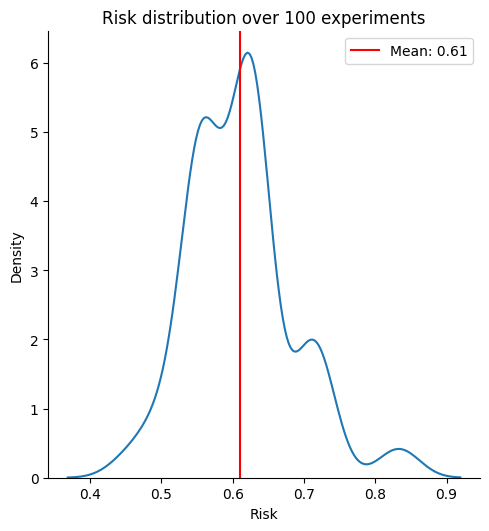

In [83]:
plot_risk_distribution(10, 6, "plurality", "A", "compromising")

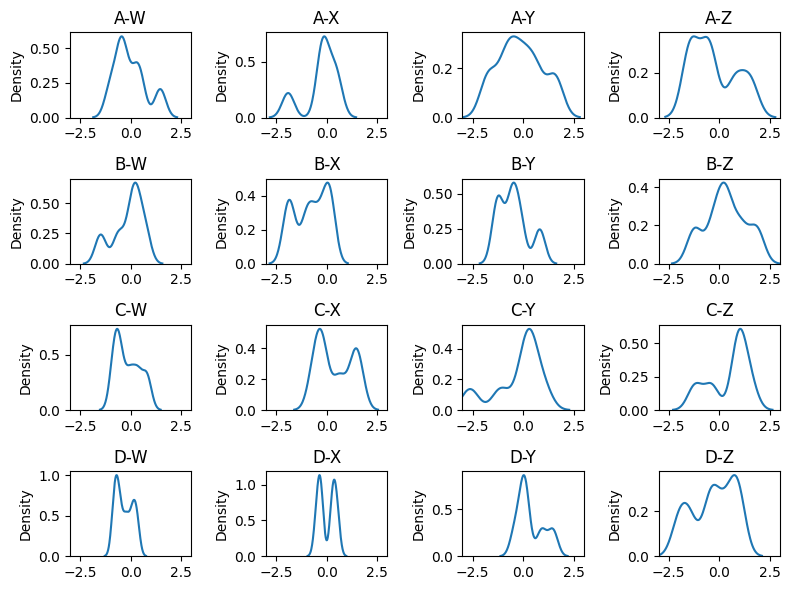

In [85]:
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
import pandas as pd

# Example DataFrame with 'Group', 'Category', and 'Value'
np.random.seed(42)
data = pd.DataFrame({
    'Group': np.repeat(['A', 'B', 'C', 'D'], 25),
    'Category': np.tile(['W', 'X', 'Y', 'Z'], 25),
    'Value': np.random.randn(100)
})

# Create a pivot table to structure the data for plotting
pivot_data = data.pivot_table(index='Group', columns='Category', values='Value', aggfunc=lambda x: list(x))

fig, axs = plt.subplots(nrows=pivot_data.shape[0], ncols=pivot_data.shape[1], figsize=(8, 6))

for i, (group_idx, row) in enumerate(pivot_data.iterrows()):
    for j, (cat, cell_data) in enumerate(row.items()):
        sns.kdeplot(cell_data, ax=axs[i, j], bw_adjust=0.5)
        axs[i, j].set_title(f'{group_idx}-{cat}')
        axs[i, j].set_xlim([-3, 3])  # Assuming data is normalized

plt.tight_layout()
plt.show()
